In [13]:
import pandas as pd
import numpy as np
from altair import Chart, X, Y, SortField, Detail, Axis

In [14]:
csv_path = "../data/dropped-frames.csv"

In [15]:
df = pd.read_csv(csv_path, parse_dates=["Dropped Frame Start", "Dropped Frame End"], low_memory=False)

In [16]:
df.tail()

,Officer ID,File Date Time,Player Time Range,Frame Range,Dropped Frame Start,Dropped Frame End,Duration,FPS,Dropped Frames,Resolution,File Size,File Name
137971,7640,20170105140534,00:00:09-00:00:19,299-598,2017-01-05 22:05:43.137,2017-01-05 22:05:53.586,10.45,28.62,13,352x240,35.339 MB,7640@20170105140534.mpg
137972,7534,20170109063036,00:02:19-00:02:29,4186-4485,2017-01-09 14:32:55.134,2017-01-09 14:33:11.384,16.25,18.40,187,720x480,329.210 MB,7534@20170109063036.mpg
137973,7534,20170109063037,00:02:19-00:02:29,4186-4485,2017-01-09 14:32:56.111,2017-01-09 14:33:12.227,16.11,18.55,183,352x240,139.613 MB,7534@20170109063037.mpg
137974,7534,20170109094928,00:02:19-00:02:29,4186-4485,2017-01-09 17:51:46.896,2017-01-09 17:52:03.542,16.65,17.96,199,720x480,235.486 MB,7534@20170109094928.mpg
137975,7534,20170109094929,00:02:19-00:02:29,4186-4485,2017-01-09 17:51:47.895,2017-01-09 17:52:04.448,16.55,18.06,196,352x240,99.355 MB,7534@20170109094929.mpg


In [17]:
data = df[['Officer ID', 'Dropped Frame Start', 'Duration', 'FPS', 'Dropped Frames', 'Resolution', 'File Size', 'File Name', 'Frame Range', 'Player Time Range']]

In [18]:
data = data.rename(columns={'Dropped Frame Start': 'Timestamp'})

In [19]:
data['Duration (Hours)'] = df.apply(lambda row: row['Duration'] / 60 / 60, axis=1)
data['Duration (Minutes)'] = df.apply(lambda row: row['Duration'] / 60, axis=1)
data = data[data['Timestamp'] < '2017-01-01']

In [ ]:
## Officer ID's
Chart(data.sample(100)).mark_bar().encode(
    X('Officer ID', sort=SortField(field='Duration', op='sum', order='descending')),
    Y('sum(Duration)')
)

In [ ]:
## Officer ID's (recent)
Chart(data[data['Timestamp'] > '2015-01-01']).mark_bar().encode(
    X('Officer ID', sort=SortField(field='Duration', op='sum', order='descending')),
    Y('sum(Duration)')
)

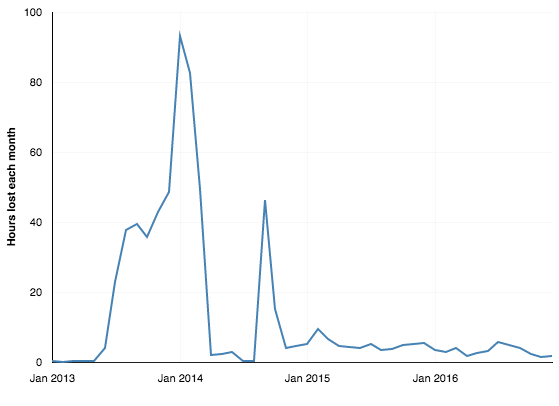

In [7]:
## Overview
Chart(data[['Timestamp', 'Duration (Hours)']]).configure_axis(gridColor='#ccc', tickSizeEnd=0, tickSize=0, tickPadding=10).mark_line(interpolate='linear', tension=2).encode(
    X(field='Timestamp', type='temporal', timeUnit='yearmonth', axis=Axis(title=' ', ticks=5, labelAngle=0)),
    Y('sum(Duration (Hours))', axis=Axis(title='Hours lost each month', ticks=5))
)

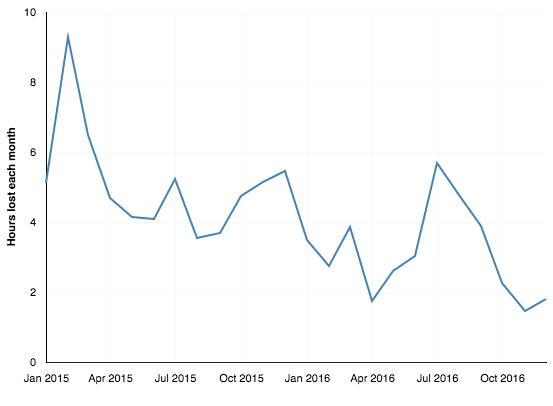

In [8]:
## Overview (Recent)
Chart(data[(data['Timestamp'] > '2015-01-01')][['Timestamp', 'Duration (Hours)']]).configure_axis(gridColor='#ccc', tickSizeEnd=0, tickSize=0, tickPadding=10).mark_line(interpolate='linear', tension=2).encode(
    X(field='Timestamp', type='temporal', timeUnit='yearmonth', axis=Axis(title=' ', ticks=5, labelAngle=0)),
    Y('sum(Duration (Hours))', axis=Axis(title='Hours lost each month', ticks=5))
)

In [ ]:
## Duration per officer
Chart(data[data['Timestamp'] > '2015-01-01']).mark_point(opacity=0.25).encode(
    X(field='Timestamp', type='temporal', timeUnit='yearmonth'),
    Y('sum(Duration (Minutes))'),
    detail=Detail(field='Officer ID', type='nominal')
)

In [ ]:
## Duration per officer (recent)
Chart(data[data['Timestamp'] > '2015-01-01']).mark_point(opacity=0.15).encode(
    X(field='Timestamp', type='temporal', timeUnit='yearmonth'),
    Y('sum(Duration)'),
    detail=Detail(field='Officer ID', type='nominal')
)

In [ ]:
## Density of  drops
Chart(data).mark_tick().encode(
    X(field='Timestamp', type='temporal', timeUnit='yearmonthdate'),
    Y(field='Duration', bin=True, scale=Scale(type='log'))
)

In [ ]:
csv_path = "../data/mysterious.csv"

In [ ]:
df = pd.read_csv(csv_path, parse_dates=["logTime"], low_memory=False)

In [ ]:
def get_id(row):
    s = row['fileName']
    return s[:s.find('@')]

In [ ]:
df['Officer ID'] = df.apply(lambda row: get_id(row), axis=1)

In [ ]:
grouped = df.groupby('Officer ID').count()

In [ ]:
## Counts per officer
Chart(df).mark_bar().encode(
    X('Officer ID', sort=SortField(field='*', op='count', order='descending')),
    Y('count(*):Q')
)


In [ ]:
grouped[grouped['ID'] > 10]

In [ ]:
grouped = df.groupby('Officer ID')

In [ ]:
g = grouped['Officer ID'].count()

In [ ]:
d = pd.DataFrame.from_dict(g.to_dict())

In [ ]:
g.to_dict()

In [ ]:
df.head()

In [ ]:
## Counts per officer (recent)
Chart(df[df['logTime'] > '2015-01-01']).mark_bar().encode(
    X('Officer ID', sort=SortField(field='*', op='count', order='descending')),
    Y('count(*):Q')
)

In [ ]:
## Counts per officer (recent)
Chart(df[df['logTime'] > '2016-01-01']).mark_bar().encode(
    X('Officer ID', sort=SortField(field='*', op='count', order='descending')),
    Y('count(*):Q')
)

In [ ]:
## Overview
Chart(df).mark_line().encode(
    X(field='logTime', type='temporal', timeUnit='yearmonth'),
    Y('count(*):Q')
)

In [ ]:
data[(data['Timestamp'] > '11-11-2015') & (data['Timestamp'] < '11-12-2015')]

In [ ]:
3597.07 / 60

In [ ]:
data[data['Duration'] > 50 * 60 ]

In [ ]:
data['Dropped Frames'].sum()

In [ ]:
data['Timestamp'].describe()

In [ ]:
data['Duration'].sum() / 60 / 60 / 24 / 7

In [ ]:
data[data['Duration'] > 5 * 60]['Officer ID'].describe()

In [ ]:
data.to_csv('dropped-frames-cleaned.csv')

In [ ]:
data['Duration'].describe()

In [20]:
def get_rank(row):
    d = row['Duration'] / 60
    if d > 30:
        return 1
    if d > 5:
        return 2
    if d > 1:
        return 3
    return 4

In [21]:
data['Duration Rank'] = df.apply(lambda row: get_rank(row), axis=1)

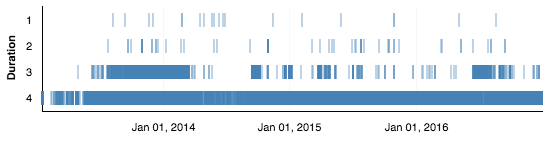

In [22]:
## Density of drops
Chart(data[['Timestamp', 'Duration Rank']]).configure_axis(gridColor='#ccc', tickSizeEnd=0, tickSize=0, tickPadding=10).mark_line(interpolate='linear', tension=2).mark_tick().encode(
    X(field='Timestamp', type='temporal', timeUnit='yearmonthdate', axis=Axis(title=' ', ticks=5, labelAngle=0)),
    Y(field='Duration Rank', type='ordinal', axis=Axis(title='Duration', ticks=5))
)

In [23]:
data[['Timestamp', 'Duration Rank']].to_csv('small.csv')